In [1]:
using CSV, DataFrames, Dates
using PyCall
using DelimitedFiles

include("./src/cubes.jl")
include("./src/network.jl")
include("./src/motifs_discovery.jl")
include("./src/motifs_analysis.jl")

volume_tetrahedrons (generic function with 1 method)

In [2]:
# Read data
path = "./data/"
region = "california"
filepath = path * region * ".csv"

"./data/california.csv"

In [3]:
df_full = CSV.read(filepath, DataFrame);

# Filters
if (region == "vrancea") || (region == "romania")
    df = df_full[df_full.Datetime .> DateTime(1976,1,1,0,0,0),:];

    df = df[(df.Latitude .>= 45.20) .& (df.Latitude .<= 46.0) .& 
            (df.Longitude .>= 26.0) .& (df.Longitude .<= 27.0) .&
            (df.Depth .>= 50.0) .& (df.Depth .<= 200.0), :];# .&
            # (df.Magnitude .> 1.0) .& (df.Magnitude .<= 4), :];

elseif region == "california"
    df = df_full[df_full.Datetime .> DateTime(1978,1,1,0,0,0),:];
    df[findall(df.Depth .< 0.001),:Depth] .= 0.0;
    println("california chosen; start year processed")
    
elseif region == "italy"
    # df = df_full[df_full.Datetime .> DateTime(1988,1,1,0,0,0),:];
    df = select(df_full, Not(:Event_Type))

elseif region == "japan"
    df = df_full[df_full.Datetime .> DateTime(1988,1,1,0,0,0),:];
end

california chosen; start year processed


In [4]:
side = 5
minimum_magnitude = 2

2

In [5]:
df_filtered = df[df.Magnitude .> minimum_magnitude,:] 

# Split into cubes
df_filtered, df_filtered_cubes = region_cube_split(df_filtered,side=side,energyRelease=true);

# Create network
MG = create_network(df_filtered, df_filtered_cubes; edgeWeight=false)

{12098, 88820} undirected Int64 metagraph with Float64 weights defined by :weight (default weight 1.0)

In [7]:
motif = "Triangle"

"Triangle"

In [8]:
network_target_path = "./networks/$(region)/side_$(string(side))km/"
motif_filename = "motif$(motif)_$(region)_side_$(string(side))km_minmag_$(string(minimum_magnitude)).csv"

motif_target_path = network_target_path * motif_filename

"./networks/california/side_5km/motifTriangle_california_side_5km_minmag_2.csv"

In [9]:
motifs = readdlm(motif_target_path, ',', Int64);
motifs;

In [10]:
motif_energy = total_mean_energy(motifs, df_filtered, df_filtered_cubes);
areas = area_triangles(motifs, df_filtered_cubes);

In [11]:
area = [value for value in values(areas)];
totalenergy = [value[1] for value in values(motif_energy)]
meanenergy = [value[2] for value in values(motif_energy)];

In [12]:
area_weight_totalenergy = []
area_weight_meanenergy = []
for key in keys(motif_energy)
    # Used to filter out zeros and very small areas (triangles on the vertical for example)
    if areas[key] > 1
        push!(area_weight_totalenergy, areas[key]/motif_energy[key][1])
        push!(area_weight_meanenergy, areas[key]/motif_energy[key][2])
    end
end

## Method 1: Simple CurveFit using Least Squares

In [15]:
using CurveFit
using Plots; gr()

include("./src/histogram_fit.jl")

power_law (generic function with 1 method)

In [16]:
h, x, y = histogram_fit(area_weight_meanenergy)

(Histogram{Float64, 1, Tuple{StepRangeLen{Float64, Base.TwicePrecision{Float64}, Base.TwicePrecision{Float64}, Int64}}}
edges:
  1.2969701702204338e-7:0.012456893051142821:305.19387988269614
weights: [57191.0, 22279.0, 15039.0, 11134.0, 8421.0, 6757.0, 5678.0, 4749.0, 4280.0, 3535.0  …  0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
closed: left
isdensity: false, Any[0.0062285762225884325, 0.018685469273731253, 0.031142362324874072, 0.043599255376016895, 0.05605614842715972, 0.06851304147830253, 0.08096993452944537, 0.09342682758058818, 0.10588372063173102, 0.11834061368287382  …  11.541311541580843, 11.553768434631984, 11.566225327683128, 11.578682220734269, 11.591139113785413, 11.603596006836554, 11.616052899887698, 11.628509792938841, 11.640966685989984, 11.653423579041128], [0.8615549003046349, 0.3356224165320935, 0.22655529970941937, 0.16772835341210687, 0.1268583136414004, 0.10179095419486314, 0.08553633830374914, 0.07154140024735904, 0.06447614088412228, 0.053253074304993514 

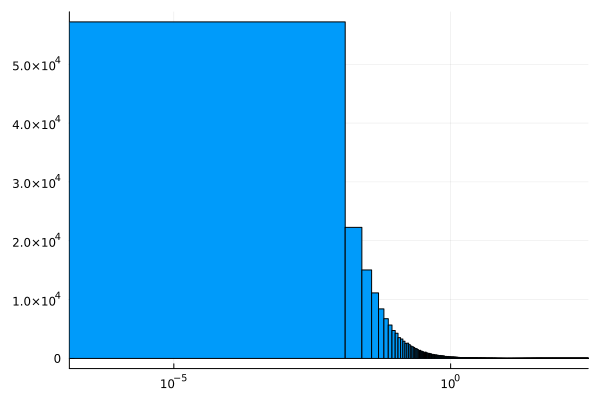

In [17]:
plot(h ; label="",xscale=:log10, xlim=extrema(area_weight_meanenergy))

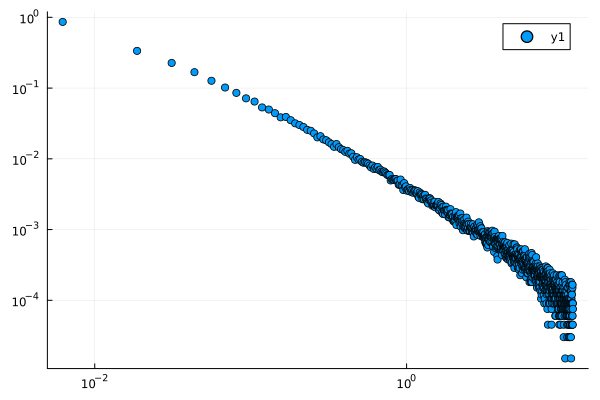

In [18]:
scatter(x,y,xscale=:log10,yscale=:log10)

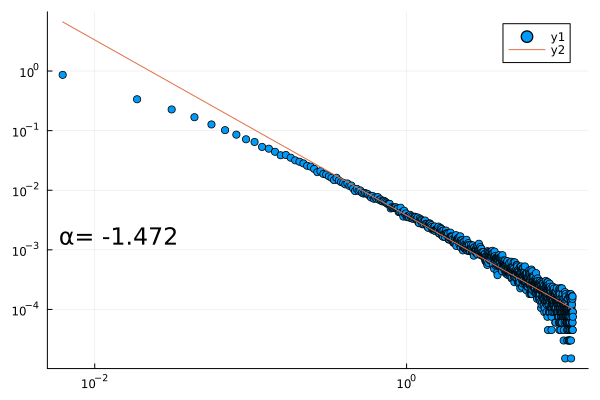

In [26]:
parameters = CurveFit.power_fit(x, y)

a = round(parameters[2],digits=4)
scatter(x, y,xscale=:log10,yscale=:log10)
plot!(x,power_law(x,parameters[1],parameters[2]))
annotate!(0.006,0.001,text("α= $a", :left, :bottom, 16))

### Without first entry

In [32]:
function power_law(x,b,a)
    return b*x .^(a)
end

power_law (generic function with 1 method)

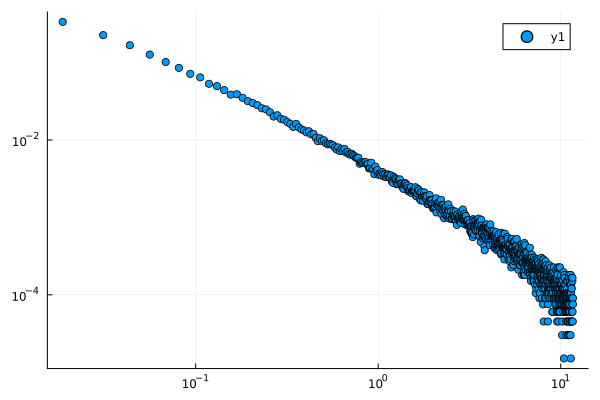

In [ ]:
scatter(x[2:end],y[2:end],xscale=:log10,yscale=:log10)

In [33]:
parameters = CurveFit.power_fit(x[2:end], y[2:end])

a = round(parameters[2],digits=4)

-1.4871

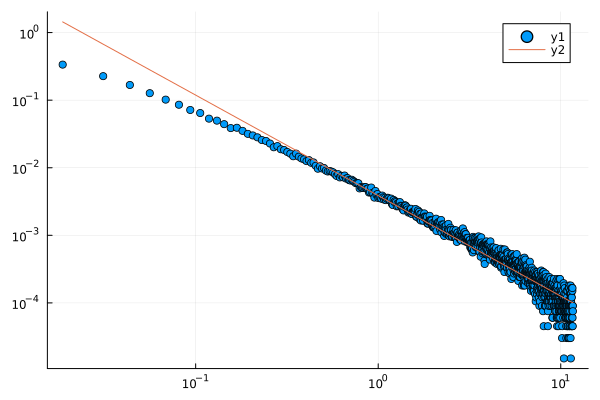

In [34]:
scatter(x[2:end], y[2:end],xscale=:log10,yscale=:log10)
plot!(x[2:end],power_law(x[2:end],parameters[1],parameters[2]))

In [ ]:

annotate!(0.006,0.001,text("α= $a", :left, :bottom, 16))

### Method 2 : MLE using python powerlaw package

In [28]:
powerlaw = pyimport("powerlaw")

PyObject <module 'powerlaw' from '/home/gabipana/.local/lib/python3.8/site-packages/powerlaw.py'>

In [36]:
py"""
import powerlaw as powerlaw
def fit_data_powerlaw(data):
    results = powerlaw.Fit(data, discrete=True)
    print(results.power_law.alpha)
    print(results.power_law.xmin)
    # R, p = results.distribution_compare('power_law', 'lognormal')
    return results.power_law.alpha, results.power_law.xmin

def plot_pdf(fit_data):
    pdf = powerlaw.pdf(fit_data)
    return pdf
"""

In [37]:
a,xmin = py"fit_data_powerlaw"(area_weight_meanenergy)

In [ ]:
function power_law(x,b,a)
    return b*x .^(-a)
end

In [ ]:
scatter(pdf,xscale=:log10, yscale=:log10)
plot!(pdf_cutoff,power_law(pdf_cutoff,xmin,a))